<a href="https://colab.research.google.com/github/bruce-goldfeder-asetpartners/Coasties-Ship-Detection-Capstone/blob/main/Image_Resize_Tile.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Import Libraries and Load Directory and Images**
Authors: Evan Twarog, Bruce Goldfeder

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from PIL import Image
import pandas as pd
import numpy as np
import os
from google.colab.patches import cv2_imshow
import cv2


## **Image Exploration**

first two filenames -  ['2019_343000e_3093000n_orthomosaic.tif', '2019_343000e_3094000n_orthomosaic.tif']
Original Image Size  (4000, 4000, 3)


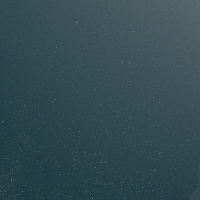

Thumbnail of a source image 0


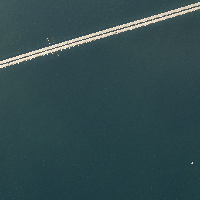

Thumbnail of a source image 1


In [ ]:

# locations for source and processed images
path_unproc = '/content/drive/MyDrive/Capstone/images_unprocessed/'
path_processed = '/content/drive/MyDrive/Capstone/processed_test/'

# get the list of image names in the unprocessed directory
unprocessed_images = os.listdir(path_unproc)
print('first two filenames - ',unprocessed_images[:2]) # list of images

# Show a downsampled thumbnail of an image
path1 = path_unproc + unprocessed_images[0]
path2 = path_unproc + unprocessed_images[100]
img1 = cv2.imread(path1)
img1_small = cv2.resize(img1,(200,200))
img2 = cv2.imread(path2)
img2_small = cv2.resize(img2,(200,200))
print('Original Image Size ',img1.shape)
cv2_imshow(img1_small)
print('Thumbnail of a source image 0')
cv2_imshow(img2_small)
print('Thumbnail of a source image 1')


# Resize the Images
This is to make the images splittable into 768 x 768 tiles required for the mask rcnn algorithm input dimensions.

In [ ]:
# Note this cell uses the Pillow library as it autoconverts to RGB on save
n = 1
while n < 10:
  # Print file paths for first ten files
  path = path_unproc + str(unprocessed_images[n])
  image = Image.open(path)

  width, height = image.size # Save Initial Image Size
  
  tile_size = 768 # Set Desired Tile Size
  
  resize_w = (width//tile_size) * tile_size
  resize_h = (height//tile_size) * tile_size

  #print('width ',resize_w, ' height ', resize_h)
  
  # note that this may not be a lossless operation in that some detail could
  # be lost in the floating point mathematics on the pixels
  new_image = image.resize((resize_w, resize_h)) # Resize

  new_image_name = path_processed + 'test' + str(n) + '.jpg'
  new_image = new_image.save(new_image_name)

  n = n + 1

# Examine the image metadata

In [ ]:
# The file format of the source file.
print("original image storage format ",image.format) 

# The pixel format used by the image. Typical values are "1", "L", "RGB", or "CMYK."
print("original image color format ", image.mode) 

# Image size, in pixels. The size is given as a 2-tuple (width, height).
print("original image size ",image.size) 

# Image size of a downscaled image
path = '/content/drive/MyDrive/Capstone/processed_test/' + 'test1.jpg'
new_image = Image.open(path)

# The file format of the downscaled file.
print("Downscaled image storage format ",new_image.format) 

# The pixel format used by the downscaled image. Typical values are "1", "L", "RGB", or "CMYK."
print("Downscaled image color format ", new_image.mode) 

# downscaled Image size, in pixels. The size is given as a 2-tuple (width, height).
print("Downscaled image size ",new_image.size) 

original image storage format  TIFF
original image color format  RGBX
original image size  (4000, 4000)
Downscaled image storage format  JPEG
Downscaled image color format  RGB
Downscaled image size  (3840, 3840)


In [ ]:
# What is RGBX?  It is just RGB with a null for X, see output for size of image data
# The fourth null entry is removed when the resize occurs!  That's cool
import imageio
path_original = '/content/drive/MyDrive/Capstone/images_unprocessed/' + str(unprocessed_images[0])
arr_source = imageio.imread(path_original)
s1 = arr_source.shape
arr_new = imageio.imread(path)
s2 = arr_new.shape
print('original shape ',s1,' new shape ',s2)

original shape  (4000, 4000, 4)  new shape  (3840, 3840, 3)


# **Transform Resized Image into Tiles**
Save the tiled output of 768 x 768 RGB images as png files in the subdirectory processed_text/tiles/

In [ ]:
def crop(filename):
  im = cv2.imread(filename)
  size = im.shape
  imgheight=im.shape[0]
  imgwidth=im.shape[1]
    
  unit = 768
  number = 5 # This is because 3840 the resize is 5 * 768
  y1 = 0
  M = 768
  N = 768

  for y in range(0,imgheight,M):
    for x in range(0, imgwidth, N):
      y1 = y + M
      x1 = x + N
      tiles = im[y:y+M,x:x+N]

      cv2.rectangle(im, (x, y), (x1, y1), (0, 255, 0))
      if x == 0:
        coord1 = 0
      else:
        coord1 = x//unit
      if y == 0:
        coord2 = 0
      else:
        coord2 = y//unit
      cv2.imwrite(path_processed+"tiles/" + str(coord1) + '_' + str(coord2)+".png",tiles)
 
path = path_processed + 'test5.jpg'
crop(path)

In [ ]:
path_crop_test = path_processed + "tiles/" + "0_0.png"
im = cv2.imread(path_crop_test)
size = im.shape
imgheight=im.shape[0]
imgwidth=im.shape[1]
print("Tiled image width ", imgwidth, " and height ",imgheight)

Tiled image width  768  and height  768


# Testing the Crop function

(3840, 3840, 3)


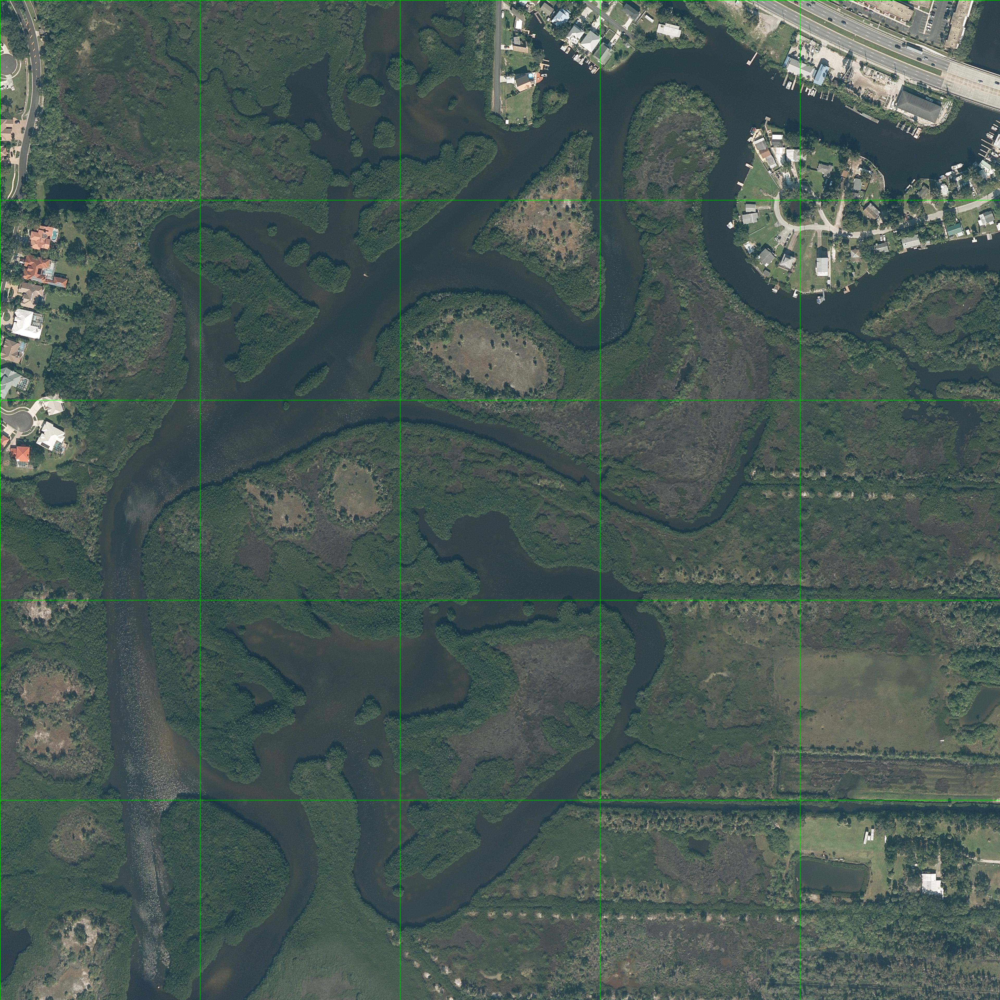

In [ ]:
def crop_test_reconstruct():
  # np.concatenate((array2D_1,array2D_2),axis=1)
  num = 5  # for 0 to 4 index for the 5 x 5 tile reconstruction 
  
  montage = None
  for y in range(0, num):
    arr = np.zeros((768,768,3))
    for x in range(0, num):
      
      filename = path_processed + "tiles/" + str(y) + "_" + str(x) + ".png"
      im = cv2.imread(filename)
      #print (np.count_nonzero(arr))
      
      if (np.count_nonzero(arr)) == 0:
        arr = im
      else:
        arr = np.concatenate((arr,im),axis=0)
    
    if y == 0:
      montage = arr
    elif y > 0:  # add columns together
      #print("montage shape at y=",y," is ",montage.shape)
      #print("arr shape at y=",y," is ",arr.shape)

      montage = np.concatenate((montage,arr),axis=1)
      
  return montage

test_crop = crop_test_reconstruct()
print(test_crop.shape)
cv2_imshow(test_crop)
